## Deep reinforcement learning non-degree - Project 2
### Project Report

### Algorithm application
>  This project focused on controlling a 2-DOF arm to reach a random target point, since the action space is a 4D continuous space, a policy gradient algorithm can better fit this problem.

>  For this problem, we select the Deep Deterministic Policy Gradient (DDPG) algoriothm

> The programs includes:

    1. ddpg_agent.py : the smart agent of the DDPG algorithm
    2. model.py: the neural network which includes an actor and a critic network
    3. ContinuousControlDDPG.ipynd: the main training program
    


### Agent Configuration
| <center>Parameter</center>   | <center>Symbol</center>      | <center>Value</center>    |
| ----------- | ----------- | ----------- |
| Learning Rate of actor network | $\alpha$<sub>actor</sub> | 1e-4
| Learning Rate of critic network | $\alpha$<sub>critic</sub> | 1e-3
| Buffer_Size | NA | 1e5|
| Batch_Size | NA | 128 |
| Tau | $\tau$ | 1e-3
| Weight Decay | NA | 0


### Network Configuration
Both actor and critic networks has one hidden layer, the input of each layer was batch normalized since the state space at different unit could result in a failed training. For example:
self.bn1 = nn.BatchNorm1d(state_size)
self.fc1 = nn.Linear(state_size, fc1_units)

### Training Configuration
The training ran 500 episodes, the maximum allowed step number of each episode is 1000 steps.

### Result
The reward converged after 50 episodes and the stable reward is about 35.
- The result diagram
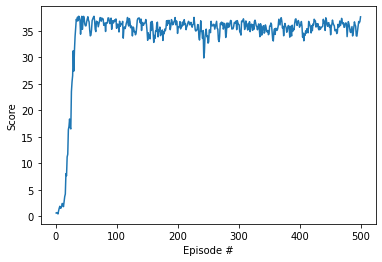

- The recorded video
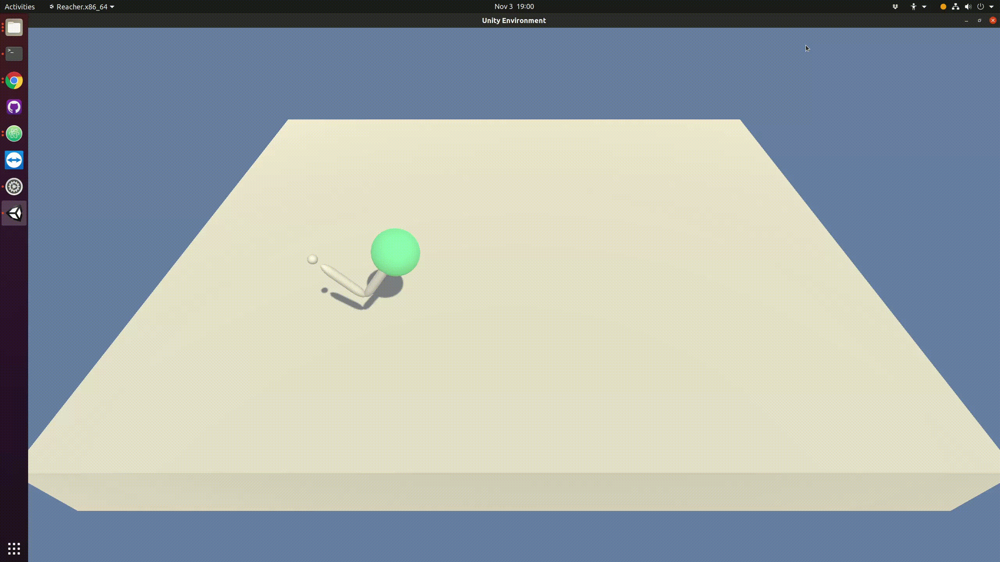

### Replay
To replay the trained agent, run the following block.

In [3]:
from unityagents import UnityEnvironment
import numpy as np
env = UnityEnvironment(file_name='Reacher_Linux_single/Reacher_Linux/Reacher.x86_64')
# get the default brain
brain_name = env.brain_names[0]
brain = env.brains[brain_name]
# reset the environment
env_info = env.reset(train_mode=True)[brain_name]
# number of agents
num_agents = len(env_info.agents)
# size of each action
action_size = brain.vector_action_space_size
# examine the state space 
states = env_info.vector_observations
state_size = states.shape[1]
import random
import torch
from collections import deque
import matplotlib.pyplot as plt
%matplotlib inline
import ddpg_agent
from ddpg_agent import Agent
agents = Agent(state_size=state_size, action_size=action_size, random_seed=0, num_agents = num_agents) # instantiate the agent
# load the weights from file
agents.actor_local.load_state_dict(torch.load('checkpoint_actor.pth'))
agents.critic_local.load_state_dict(torch.load('checkpoint_critic.pth'))

for i in range(10):
    env_info = env.reset(train_mode=False)[brain_name]
    state = env_info.vector_observations
    for j in range(200):
        action = agents.act(state)
        env_info = env.step(action)[brain_name]
        state = env_info.vector_observations
        reward = env_info.rewards
        done = env_info.local_done
        if np.any(done):
            break 
            
env.close()

INFO:unityagents:
'Academy' started successfully!
Unity Academy name: Academy
        Number of Brains: 1
        Number of External Brains : 1
        Lesson number : 0
        Reset Parameters :
		goal_speed -> 1.0
		goal_size -> 5.0
Unity brain name: ReacherBrain
        Number of Visual Observations (per agent): 0
        Vector Observation space type: continuous
        Vector Observation space size (per agent): 33
        Number of stacked Vector Observation: 1
        Vector Action space type: continuous
        Vector Action space size (per agent): 4
        Vector Action descriptions: , , , 
